# Store Item Demand Forecast

## Introduction

Time series is present in almost all areas of knowledge: physics, stock market, medicine, product demand and many others. Due to it's importance we decided to explore a dataset of multivariate time series, which means that there are more than one time-dependent variable being analyzed, and tried a different approach to forecast the demand for the next year.

The dataset is a csv file available at [Kaggle](https://www.kaggle.com/c/demand-forecasting-kernels-only/overview) and contains sales data from 50 different items sold by 10 different stores from 2013 to 2017 (this gives us a total of 500 time series to be predicted). This data was used in a competition on Kaggle in 2019 and the idea was to use it to predict item demand for the first trimester of 2018 on the 10 stores (test.csv). However in this project we will use data from 2013 to 2016 and try to forecast data from 2017 in order to check if our model has a good performance.

## Data Preparation

First we need to import the packages that we will use during the project. We also customize our graphics and font.

In [35]:
import warnings 
import pandas as pd 
import numpy as np 
from pylab import mpl, plt
import seaborn as sns
import datetime
%matplotlib inline
warnings.filterwarnings("ignore")

In [36]:
plt.style.use('seaborn')
mpl.rcParams['axes.labelsize'] = 14
mpl.rcParams['xtick.labelsize'] = 12
mpl.rcParams['ytick.labelsize'] = 12
mpl.rcParams['text.color'] = 'k'
mpl.rcParams['font.family'] = 'serif'
plt.rcParams["figure.figsize"] = [16, 8]

Following what is proposed as the evaluation metric for the competition we will use the [sMAPE](https://en.wikipedia.org/wiki/Symmetric_mean_absolute_percentage_error) (symmetric mean absolute percentage error), which is an accuracy measure based on percentage errors, defined as
\begin{equation} \text{SMAPE} = \frac{100\text{%}}{n} \sum_{t=1}^n 2\frac{\|F_t-A_t\|}{(\|A_t\| + \|F_t\|)} \end{equation}
where $n$ is the number of fitted points, $A_t$ is the actual value and $F_t$ is the forecast value. As a reference, values between 10 and 20 are considered a good forecast. Values bellow 10 are really good. 
We will also use root mean squared error to evaluate our models.

In [ ]:
def smape(A, F):
    return 100/len(A) * np.sum(2 * np.abs(F - A) / (np.abs(A) + np.abs(F)))

In [ ]:
from sklearn.metrics import mean_squared_error
def rmse(A, F):
    return np.sqrt(mean_squared_error(A,F))

Now we import the file train.csv as a dataframe using pandas. Checking the first five rows we can see that asside from the date we also have labels for store and item.

In [5]:
df=pd.read_csv('train.csv',index_col=0,parse_dates=True) 

In [7]:
df

,store,item,sales
date,,,
2013-01-01,1,1,13
2013-01-02,1,1,11
2013-01-03,1,1,14
2013-01-04,1,1,13
2013-01-05,1,1,10
...,...,...,...
2017-12-27,10,50,63
2017-12-28,10,50,59
2017-12-29,10,50,74


In [8]:
df.shape

(913000, 3)

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 913000 entries, 2013-01-01 to 2017-12-31
Data columns (total 3 columns):
 #   Column  Non-Null Count   Dtype
---  ------  --------------   -----
 0   store   913000 non-null  int64
 1   item    913000 non-null  int64
 2   sales   913000 non-null  int64
dtypes: int64(3)
memory usage: 27.9 MB


In [10]:
"""summary statistics grouped by store to check for
sales on each of them."""
df.groupby(['store'])['sales'].describe().T

store,1,2,3,4,5,6,7,8,9,10
count,91300.000000,91300.000000,91300.000000,91300.000000,91300.000000,91300.000000,91300.000000,91300.000000,91300.000000,91300.000000
mean,47.268379,67.033165,59.530602,54.902946,39.770164,39.733516,36.363735,64.142048,55.049025,58.709288
std,24.006252,33.595810,29.974102,27.733097,20.365757,20.310451,18.684825,32.231751,27.832186,29.554994
min,1.000000,3.000000,3.000000,4.000000,2.000000,0.000000,1.000000,4.000000,4.000000,3.000000
25%,28.000000,40.000000,35.000000,32.000000,23.000000,23.000000,21.000000,38.000000,32.000000,35.000000
50%,44.000000,62.000000,55.000000,51.000000,37.000000,37.000000,34.000000,60.000000,51.000000,54.000000
75%,63.000000,89.000000,80.000000,73.000000,53.000000,53.000000,49.000000,86.000000,74.000000,78.000000
max,155.000000,231.000000,196.000000,186.000000,130.000000,134.000000,122.000000,204.000000,195.000000,187.000000


## Exploratory Data Analysis

Since we have no relevant outliers and no missing or strange values we will start exploring our data. To better understand it we will reorganize this table as a pivot table

In [11]:
ptab = pd.pivot_table(df,values = 'sales', index = ['store','date'],columns = 'item')
ptab

item              1   2   3   4   5   6   7   ...  44  45  46  47  48  49  50
store date                                    ...                            
1     2013-01-01  13  33  15  10  11  31  25  ...  20  37  30  17  21  18  30
      2013-01-02  11  43  30  11   6  36  23  ...  15  40  30  15  26  10  32
      2013-01-03  14  23  14   8   8  18  34  ...  11  42  30   5  25  17  25
      2013-01-04  13  18  10  19   9  19  36  ...  22  49  37  13  26  22  32
      2013-01-05  10  34  23  12   8  31  38  ...  19  52  28  12  28  15  35
...               ..  ..  ..  ..  ..  ..  ..  ...  ..  ..  ..  ..  ..  ..  ..
10    2017-12-27  19  43  32  16  19  47  47  ...  22  64  50  16  52  24  63
      2017-12-28  12  35  33  29  14  72  53  ...  30  79  48  21  36  29  59
      2017-12-29  23  53  39  22  20  59  56  ...  30  72  69  18  59  26  74
      2017-12-30  26  56  34  15  21  52  60  ...  30  76  72  10  54  40  62
      2017-12-31  27  60  39  35  20  61  63  ...  40  89  70  22  60  42  82

[18260 rows x 50 columns]

Focusing on item 1 we can plot it's time series for all different stores. While the series varies in amplitude for each store we can notice a very similar pattern repeating itself every year, which makes sense since for differente moments of the year sales can increase or decrease due to holidays and vacations. There's also a possible positive trend over the years, showing an increasing of sales. We will further explore this soon.

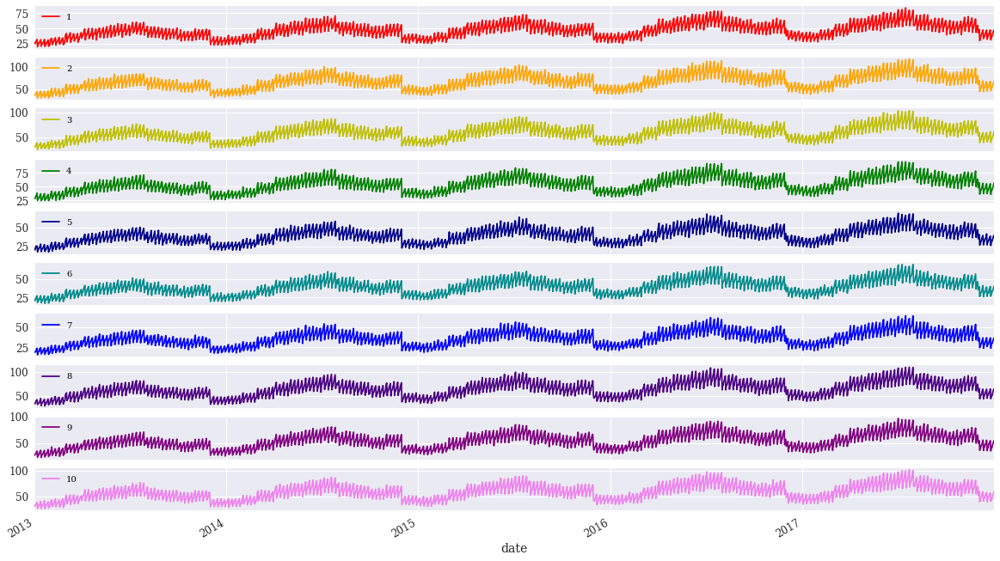

In [12]:
df1 = pd.pivot_table(df, values = 'sales', index = ['date'], columns = 'store')
df1.plot(figsize = (20,12),subplots = True, color=['r','orange', 'y','g','darkblue',
                                                   'darkcyan','blue','indigo','purple','violet']);

To check for general sales of item 1 on each store we can use a boxplot, the red triangle in each box represents the mean.

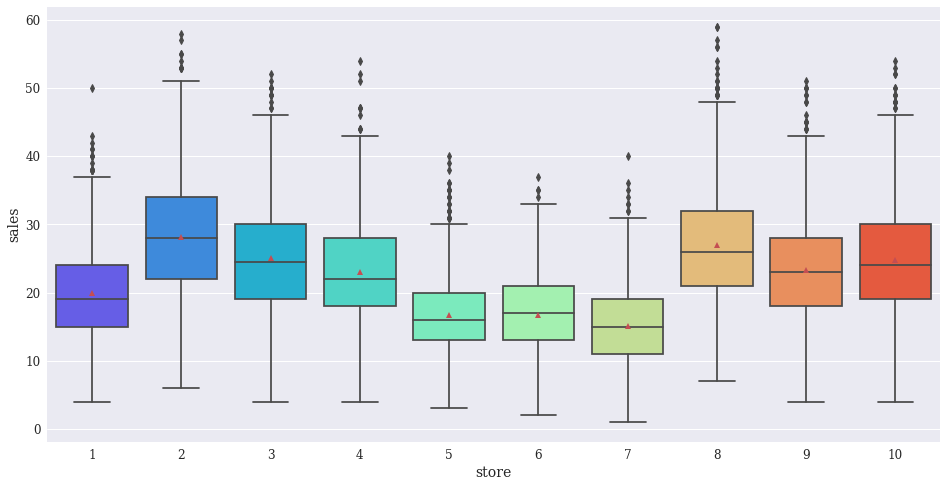

In [13]:
sns.boxplot(x = 'store', y='sales',data=df[df['item']==1],showmeans=True, palette='rainbow');

We can also check which items sells more on all stores

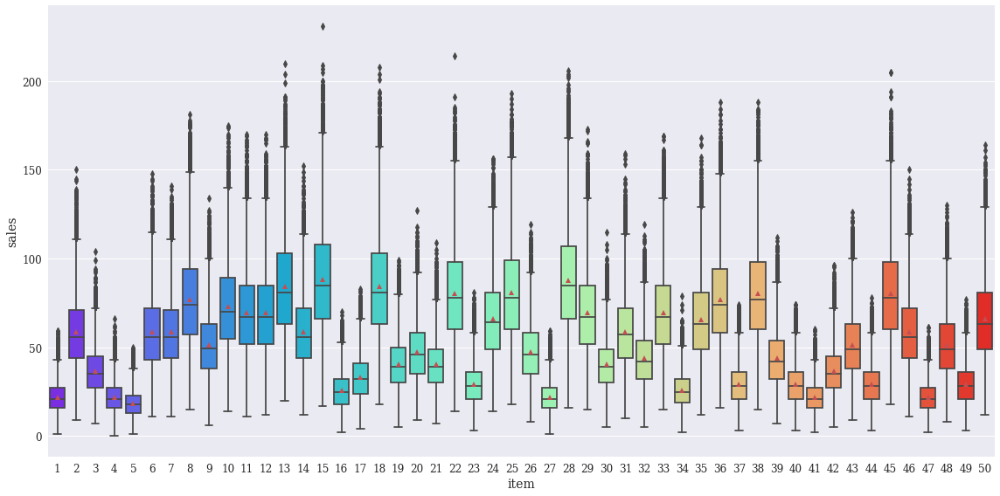

In [14]:
sns.boxplot(x = 'item', y='sales',data=df,showmeans=True, palette='rainbow')
plt.tight_layout();

Finally we can use boxplots to confirm a positive trend on sales per year on all stores

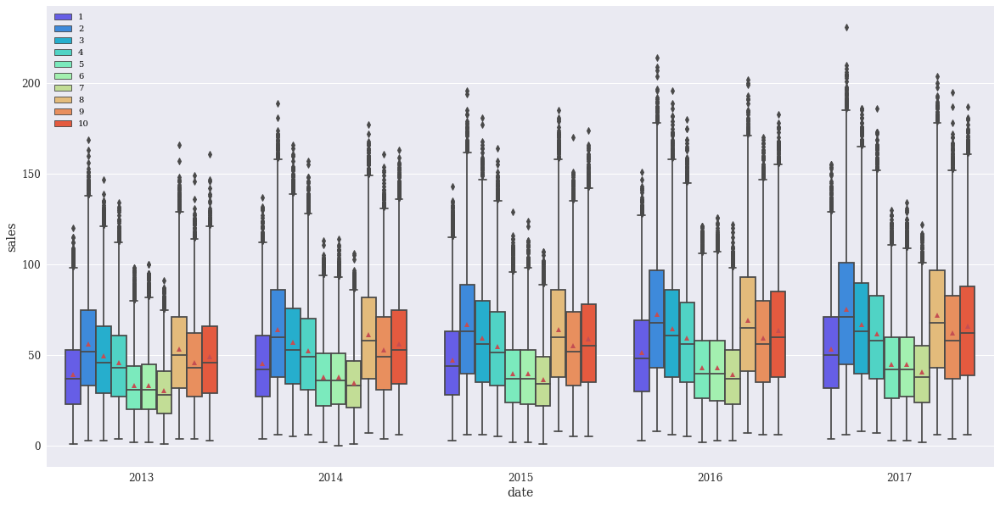

In [15]:
plt.figure(figsize = (20,10))
sns.boxplot(x=df.index.year, y='sales',data = df, hue='store',showmeans=True,palette='rainbow')
plt.legend(loc='best');

## Feature Engineering
To further explore possible patterns and trends on different time windows we will use the datetime module to split dates in six different new features: day of the month (1-31), week of the year(1-53), day of the week(0-6), month (1-12), day of the year (1-366) and year (2013-2017). 

In [6]:
df['day'] = df.index.day
df['week'] = df.index.week
df['dayofweek'] = df.index.dayofweek
df['month'] = df.index.month
df['dayofyear'] = df.index.dayofyear
df['year'] = df.index.year

Let's check the general temporal behavior of total sales of all stores. The smooth lines are an average of all values from the dataset.

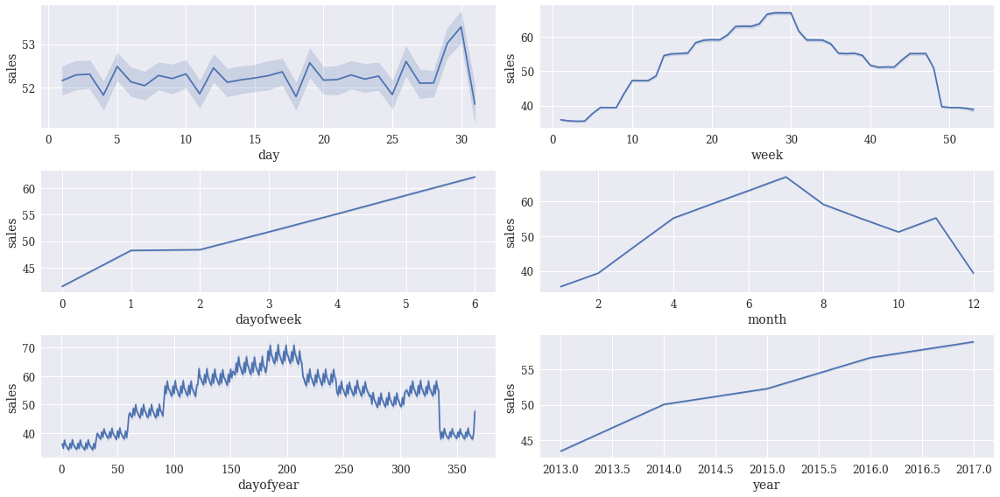

In [17]:
plt.subplot(321)
sns.lineplot(x='day', y='sales', data = df)
plt.subplot(322)
sns.lineplot(x='week', y='sales', data = df)
plt.subplot(323)
sns.lineplot(x='dayofweek', y='sales', data = df)
plt.subplot(324)
sns.lineplot(x='month', y='sales', data = df)
plt.subplot(325)
sns.lineplot(x='dayofyear', y='sales', data = df)
plt.subplot(326)
sns.lineplot(x='year', y='sales', data = df)
plt.tight_layout();

These plots shows interesting patterns. We can notice that there is a positive trend for "days of the week", implying that sales increase on weekends, and for "year" as we noted from the boxplots from last session. We can also see that sales increase monthly to a peak on july and then decreases having a second smaller peak on november.
We can check the relation between all features using a heatmap of the correlations. As one can expect, "year" and "day of the week" have higher correlation value with sales.

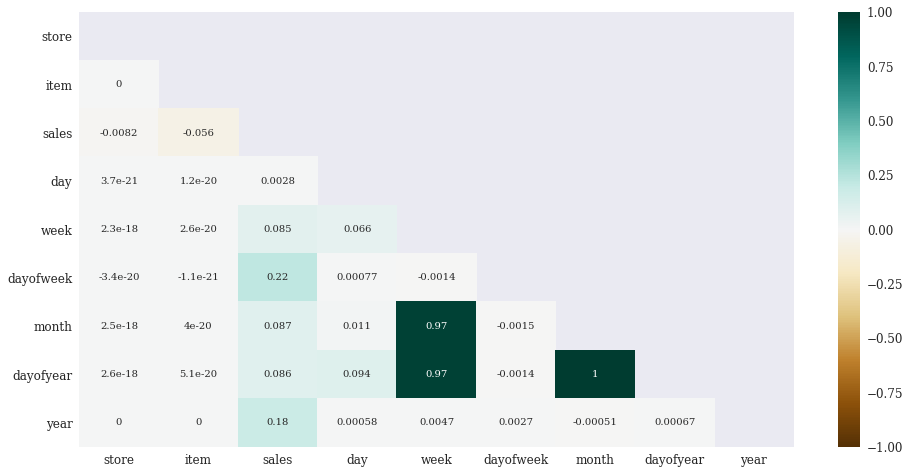

In [18]:
mask = np.triu(np.ones_like(df.corr(), dtype=bool))
sns.heatmap(df.corr(), annot=True,mask=mask, vmin=-1, vmax=1, cmap='BrBG');

From this heatmap we can see that sales has a positive correlation with all temporal features and negative correlation with store and items. On the other hand, as expected from the previous plots, week, dayofyear and month have high to perfect correlation between themselves and similar correlation value with sales. Due to this redundancy we will keep only the month feature. 

In [10]:
df.drop(['dayofyear','week'],axis=1, inplace=True)

## Model Selection
Now we will try to predict all sales for the year of 2017 using a model to predict all 500 time-series together.

### Base model
First we will use a simple Decision Tree model and use it as a base of what we should expect to achieve with this approach.

In [15]:
from sklearn.model_selection import cross_val_score,KFold
from sklearn.metrics import make_scorer
from sklearn.tree import DecisionTreeRegressor

In [13]:
train_set= df[df.index.year<=2016]
test_set= df[df.index.year==2017]

X = train_set.drop(['sales'], axis=1)
y = train_set['sales']

We will use 10-fold cross validation to check if our model has a good average value for the SMAPE.

In [ ]:
cv=KFold(n_splits=10, random_state=0, shuffle=True)

In [16]:
dtree = DecisionTreeRegressor(random_state=0)
scores_dtree= cross_val_score(dtree,X,y,n_jobs=-1,cv=cv,scoring=make_scorer(smape))

In [17]:
scores_dtree.mean()

19.089207442681953

In [18]:
dtree.fit(X,y)

DecisionTreeRegressor(random_state=0)

In [21]:
forecast_dtree = dtree.predict(test_set.drop(['sales'], axis=1))

Comparing the forecast with the true values we note that we have achieved a smaller value for SMAPE with the test set than the train set.

In [23]:
print('Results - RMSE:{}, SMAPE:{}'.format(rmse(test_set['sales'],forecast),smape(test_set['sales'],forecast_dtree)))

Results - RMSE:11.244170483544515, SMAPE:17.340727388104725


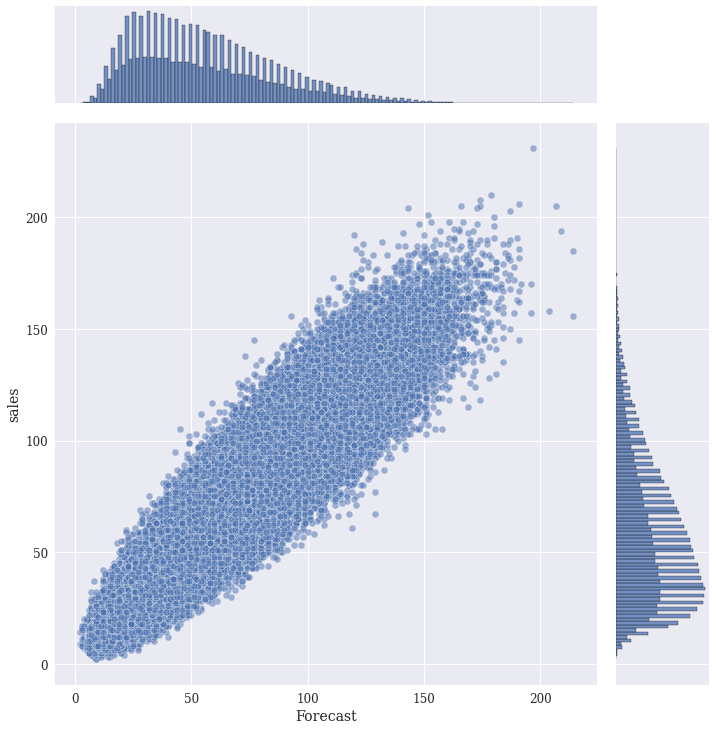

In [86]:
fig= sns.jointplot(x=forecast,y=test_set['sales'], height=10,alpha=0.5)
fig.ax_joint.set_xlabel('Forecast');

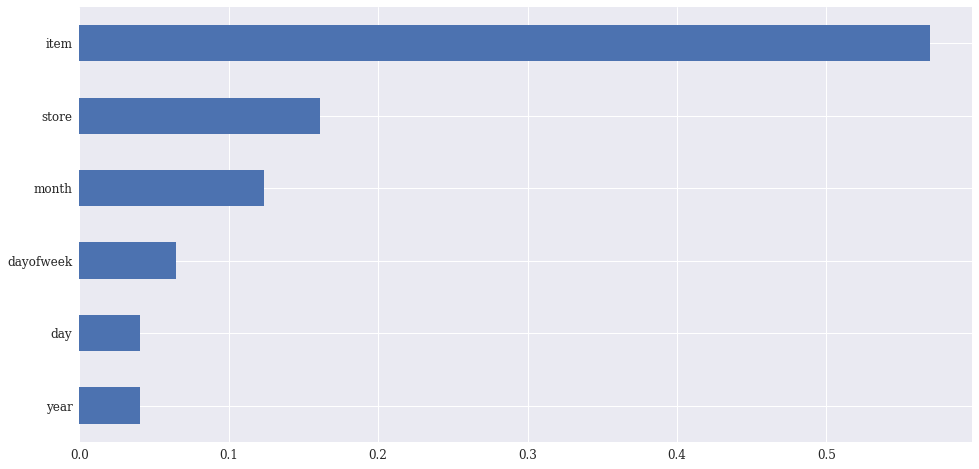

In [37]:
feat_importances = pd.Series(dtree.feature_importances_, index=X.columns)
feat_importances.nsmallest(8).plot(kind='barh');

From this we can see that there's still room to improve. We can also note that item and store are the most important features for the predictions.

### A Better Model
Now we will use the Light Gradient Boosting Machine (lightGBM), which is pretty common on Kaggle competitions and usually achieves very good results. This model uses an ensemble of trees like a Random Forest, but uses different methods to create and combine the trees.

There are many parameters that we can tune in order to achieve better results, but we will simply use 1000 trees for testing how our predictions will be improved.

In [33]:
from lightgbm import LGBMRegressor, plot_importance

We will treat store, item, month, year and day of week as categorical features and use lightGBM native support for categorical features. Using a 10-fold cross validation we achieve a lower result than the base model. Predicting for the year of 2017 we achieve an even lower value for SMAPE.


In [27]:
lgbm = LGBMRegressor(n_estimators= 1000, random_state=0, cat_features = ['store','item','dayofweek', 'month', 'year'])
scores_lgbm = cross_val_score(lgbm,X,y,n_jobs=-1,cv=cv,scoring=make_scorer(smape))

In [28]:
scores_lgbm.mean()

12.95542116391498

In [30]:
lgbm.fit(X,y)

forecast_lgbm = lgbm.predict(test_set.drop(['sales'], axis=1))
print('Results - RMSE:{}, SMAPE:{}'.format(rmse(test_set['sales'],forecast_lgbm),smape(test_set['sales'],forecast_lgbm)))

Results - RMSE:8.19753124649796, SMAPE:12.297086767117783


<AxesSubplot:title={'center':'Feature importance'}, xlabel='Feature importance', ylabel='Features'>

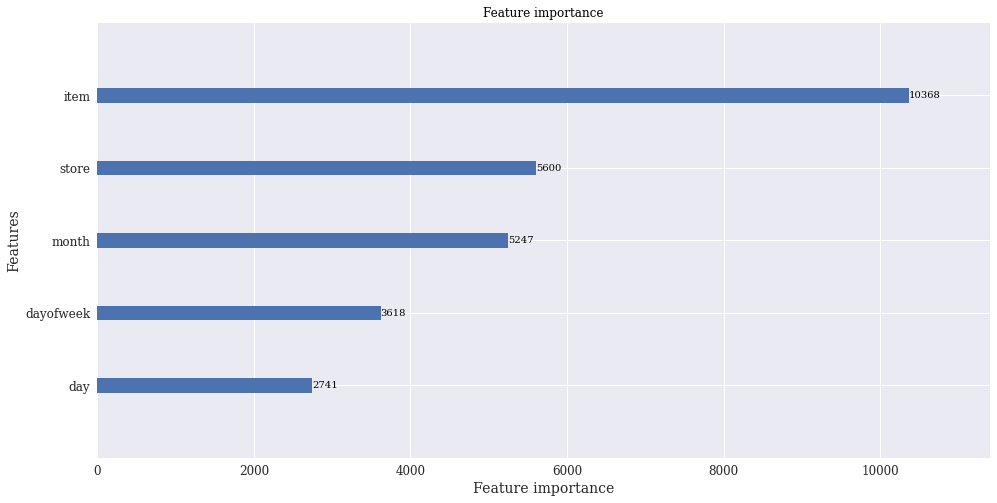

In [38]:
plot_importance(lgbm, max_num_features=5)

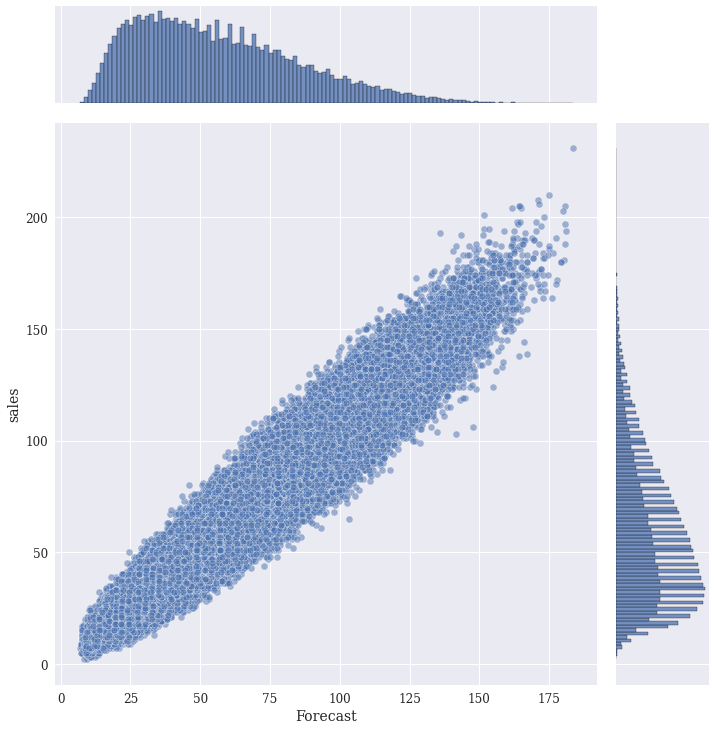

In [40]:
fig=sns.jointplot(x=forecast_lgbm,y=test_set['sales'], height=10,alpha=0.5)
fig.ax_joint.set_xlabel('Forecast');

## Conclusion
We tried a different approach to predict future sales for multiple time series using a standard machine learning procedure. Usually features based on past sales would be engineered, but here we explored temporal patterns and generated new features based only on dates. We also applied a simultaneous forecast instead of focusing on a single time series. We achieved a reasonable result with SMAPE ~ 12.3, which is a good forecast result according to the literature.